## Setup and Install Dependencies

In this section, we install the required libraries and clone the necessary repositories for SAM.


In [ ]:
!pip install torch torchvision
!pip install git+https://github.com/facebookresearch/detectron2.git
!pip install opencv-python-headless
!pip install numpy
!pip install matplotlib
!pip install scikit-image
!pip install Pillow


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!git clone https://github.com/facebookresearch/segment-anything.git


Cloning into 'segment-anything'...
remote: Enumerating objects: 295, done.
remote: Total 295 (delta 0), reused 0 (delta 0), pack-reused 295
Receiving objects: 100% (295/295), 18.30 MiB | 29.99 MiB/s, done.
Resolving deltas: 100% (155/155), done.


In [3]:
%cd segment-anything

/content/segment-anything


In [4]:
!pip install -e .

Obtaining file:///content/segment-anything
  Preparing metadata (setup.py) ... done
  Running setup.py develop for segment-anything


In [5]:
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth


--2024-05-31 10:22:46--  https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.163.189.14, 3.163.189.108, 3.163.189.51, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.163.189.14|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2564550879 (2.4G) [binary/octet-stream]
Saving to: ‘sam_vit_h_4b8939.pth’

sam_vit_h_4b8939.pt 100%[===================>]   2.39G   160MB/s    in 18s     

2024-05-31 10:23:04 (135 MB/s) - ‘sam_vit_h_4b8939.pth’ saved [2564550879/2564550879]



## Import Libraries and Define Helper Functions

We import the necessary libraries for image processing, segmentation, and visualization. Helper functions for displaying images, masks, and boundaries are also defined.


In [ ]:
import torch
import torchvision.transforms as T
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from segment_anything import SamPredictor, sam_model_registry

# Helper function to display images
def display_image(image, title="Image"):
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')
    plt.show()


In [ ]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))


In [ ]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)
    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

def show_boxes(anns, ax):
    for ann in anns:
        box = ann['bbox']
        x0, y0, w, h = box
        ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='red', facecolor=(0,0,0,0), lw=2))


## Load SAM Model and Generate Masks

We load the pre-trained SAM model and use it to generate masks for the images. This section includes code to display the original images, the masks generated by SAM, and the bounding boxes around the detected objects.


In [7]:
from segment_anything import sam_model_registry, SamPredictor, SamAutomaticMaskGenerator

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"
device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

mask_generator = SamAutomaticMaskGenerator(sam)


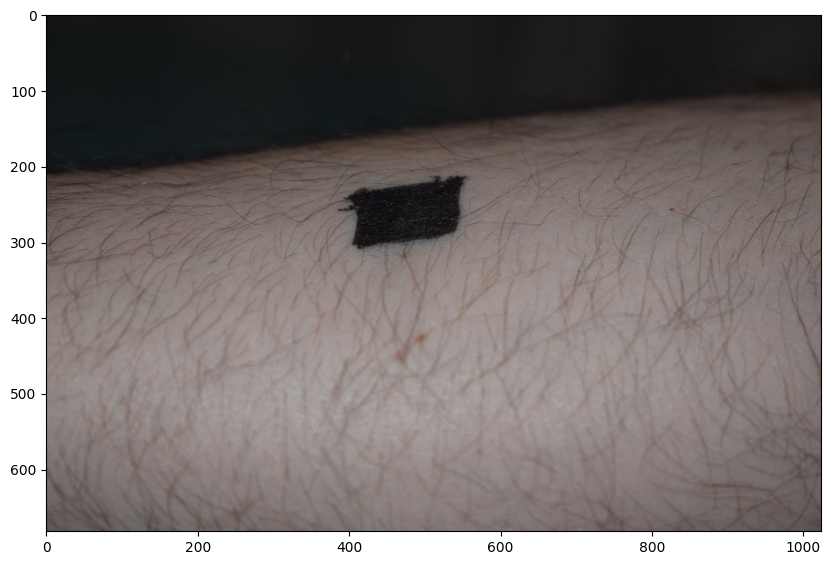

In [ ]:
image_path = '/content/drive/MyDrive/meshroom/images'  # Update this path
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 10))
# Resize the image to reduce memory usage
max_size = 1024  # Set the maximum size of the longest dimension
scale = max_size / max(image.shape[0], image.shape[1])
image = cv2.resize(image, (int(image.shape[1] * scale), int(image.shape[0] * scale)))
plt.imshow(image)
plt.axis('on')
plt.show()


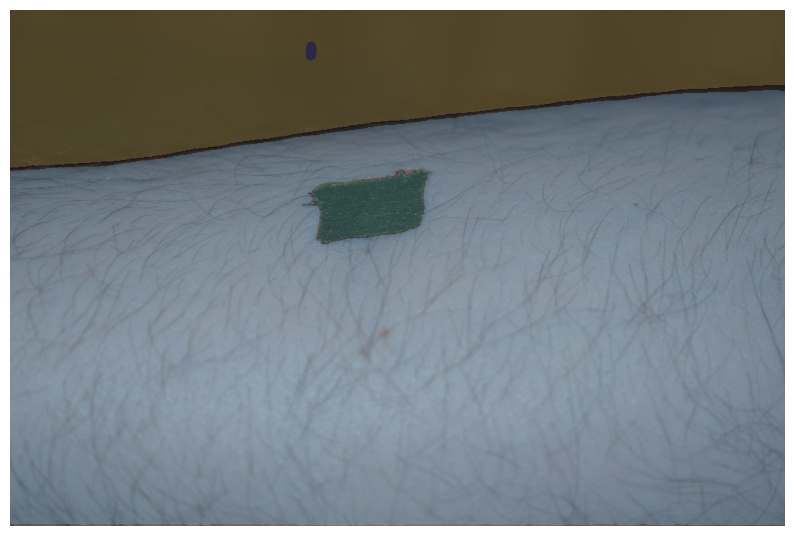

In [ ]:
masks = mask_generator.generate(image)

plt.figure(figsize=(10, 10))
plt.imshow(image)
show_anns(masks)
plt.axis('off')
plt.show()


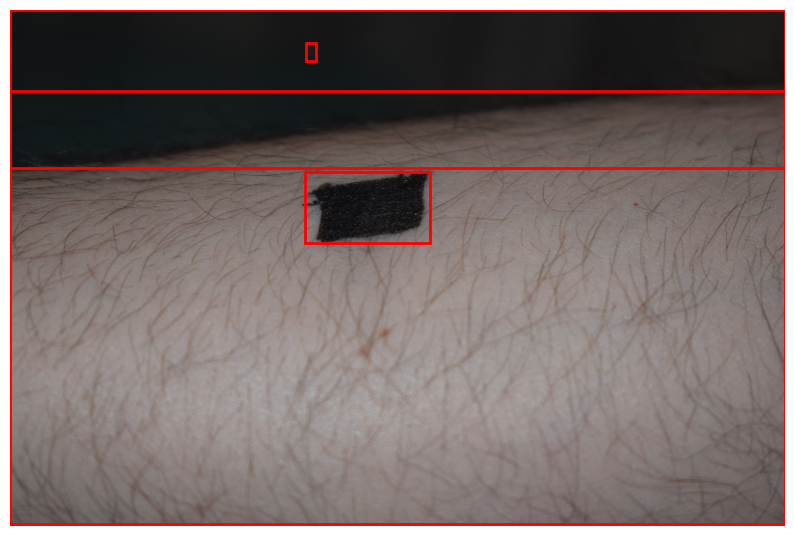

In [ ]:
plt.figure(figsize=(10, 10))
plt.imshow(image)
show_boxes(masks, plt.gca())
plt.axis('off')
plt.show()


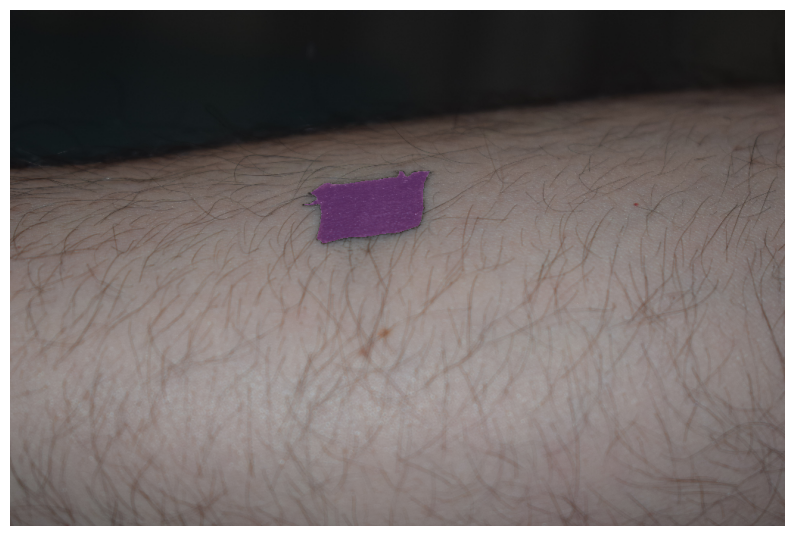

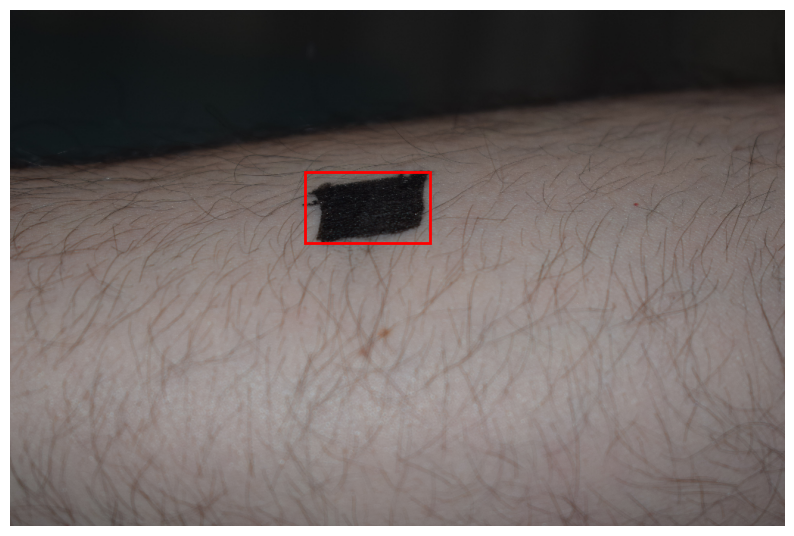

In [ ]:
min_area = 500  # Minimum area of mask to be considered (adjust as needed)
filtered_masks = [mask for mask in masks if mask['area'] > min_area]
filtered_masks = [mask for mask in filtered_masks if mask['area'] < 100000]
# Display filtered masks
plt.figure(figsize=(10, 10))
plt.imshow(image)
show_anns(filtered_masks)
plt.axis('off')
plt.show()

# Display boundaries (bounding boxes) of the filtered masks
plt.figure(figsize=(10, 10))
plt.imshow(image)
show_boxes(filtered_masks, plt.gca())
plt.axis('off')
plt.show()


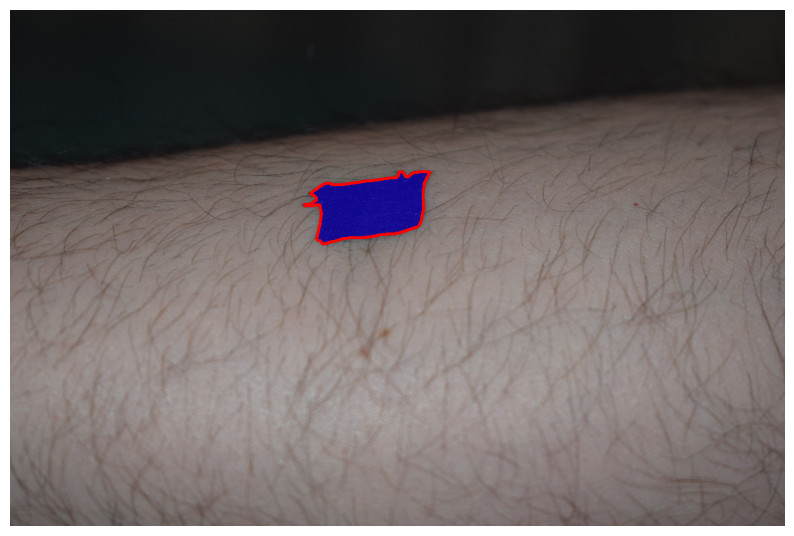

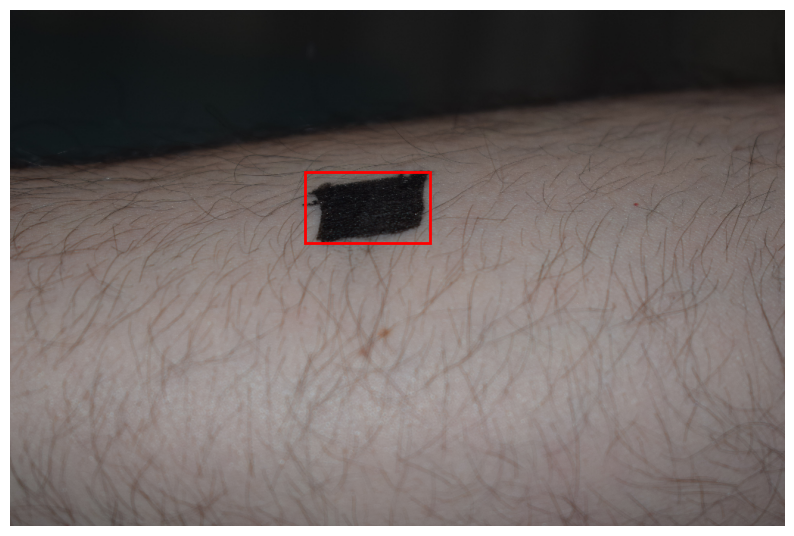

In [ ]:
# Import additional necessary library for boundary detection
from skimage import measure

# Function to draw boundaries around masks
def show_boundaries(mask, ax, color='red'):
    contours = measure.find_contours(mask, 0.5)
    for contour in contours:
        ax.plot(contour[:, 1], contour[:, 0], color=color, linewidth=2)

# Display filtered masks with boundaries
plt.figure(figsize=(10, 10))
plt.imshow(image)
for mask in filtered_masks:
    show_mask(mask['segmentation'], plt.gca(), random_color=True)
    show_boundaries(mask['segmentation'], plt.gca(), color='red')
plt.axis('off')
plt.show()

# Display boundaries (bounding boxes) of the filtered masks
plt.figure(figsize=(10, 10))
plt.imshow(image)
show_boxes(filtered_masks, plt.gca())
plt.axis('off')
plt.show()


## Process Images in a Directory

We iterate through all images in a specified directory, apply the SAM model to segment them, and save the segmented results and their corresponding boundaries.


Processing image: DSC_9388.jpg


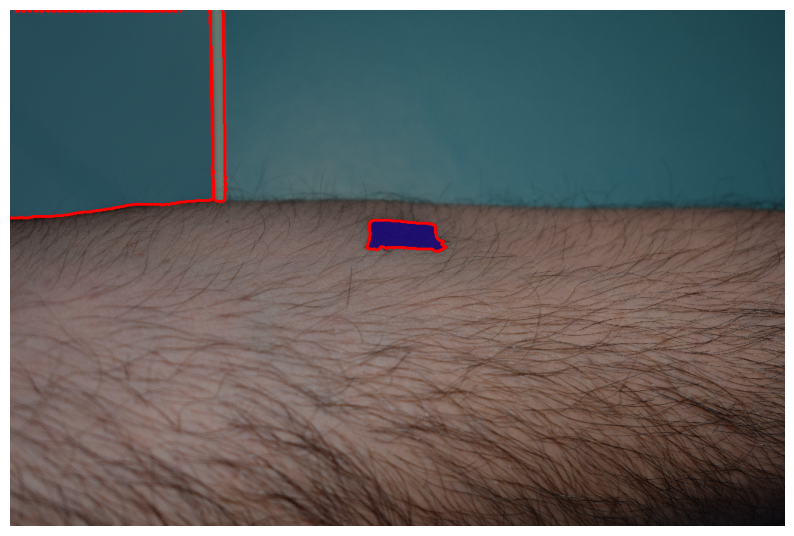

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9388_segmented.png


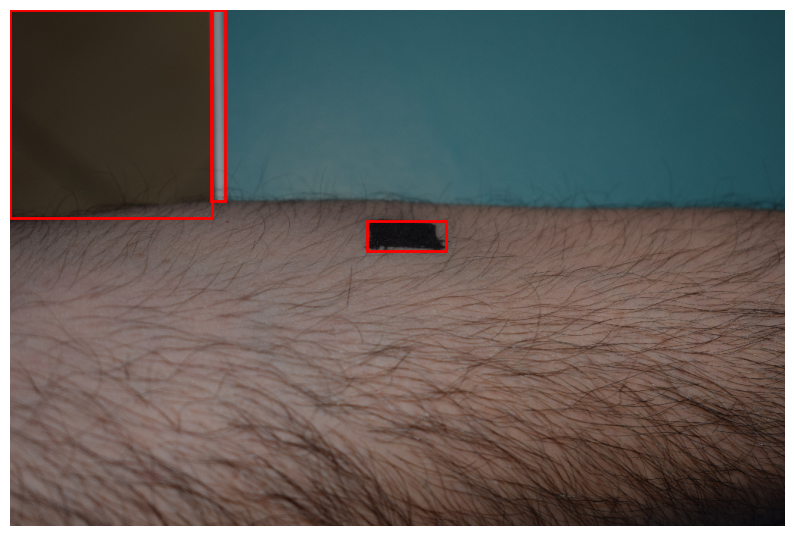

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9388_boundaries.png
Processing image: DSC_9384.jpg


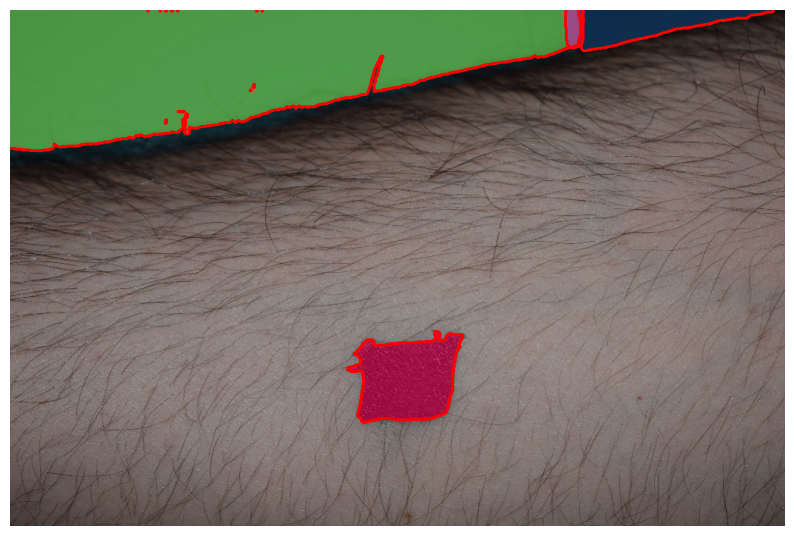

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9384_segmented.png


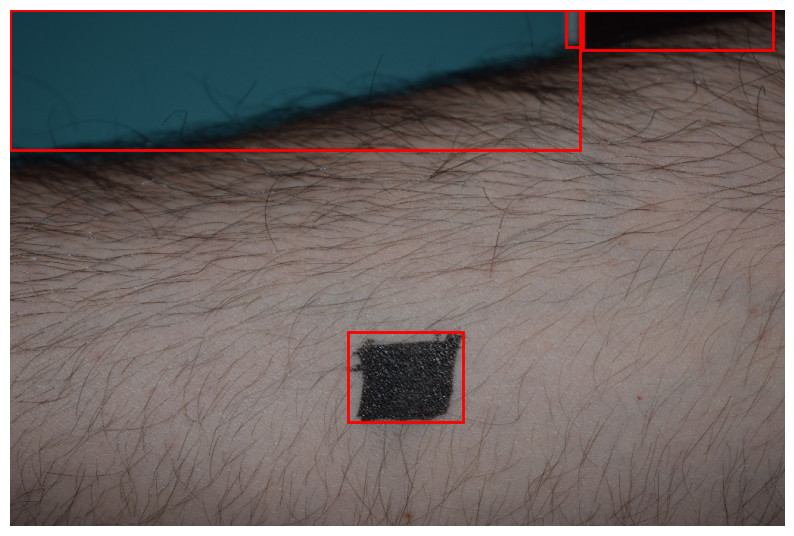

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9384_boundaries.png
Processing image: DSC_9391.jpg


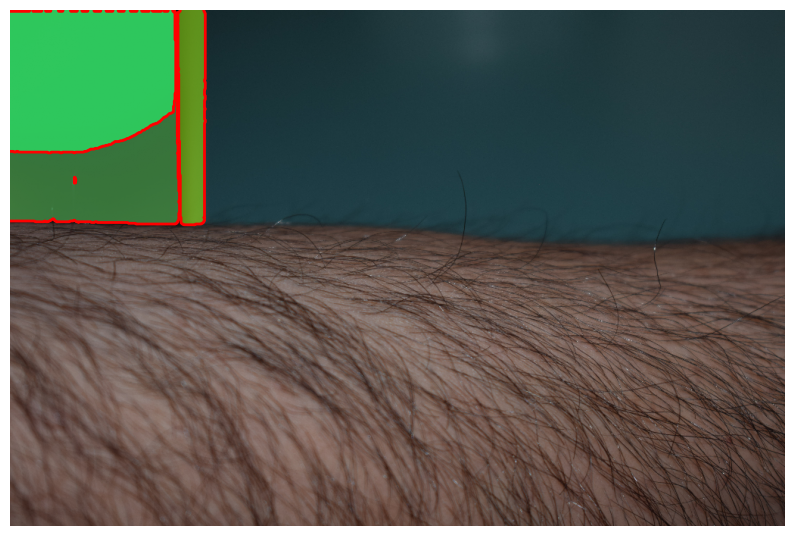

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9391_segmented.png


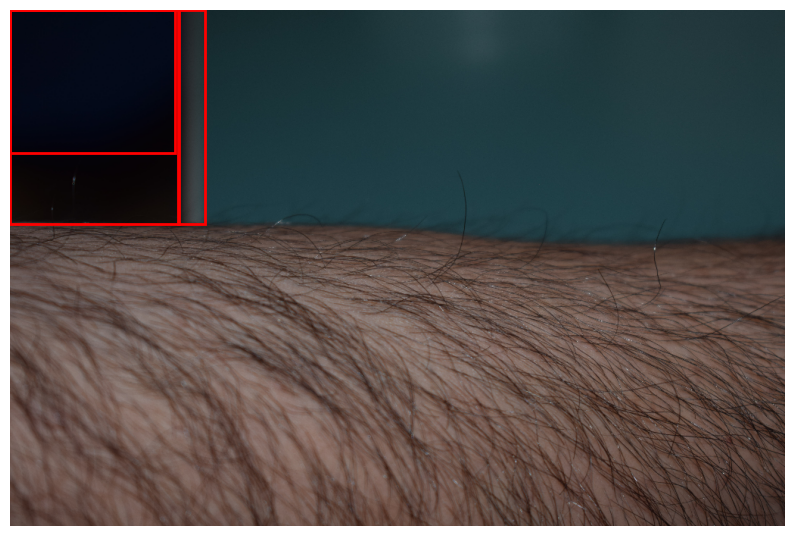

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9391_boundaries.png
Processing image: DSC_9389.jpg


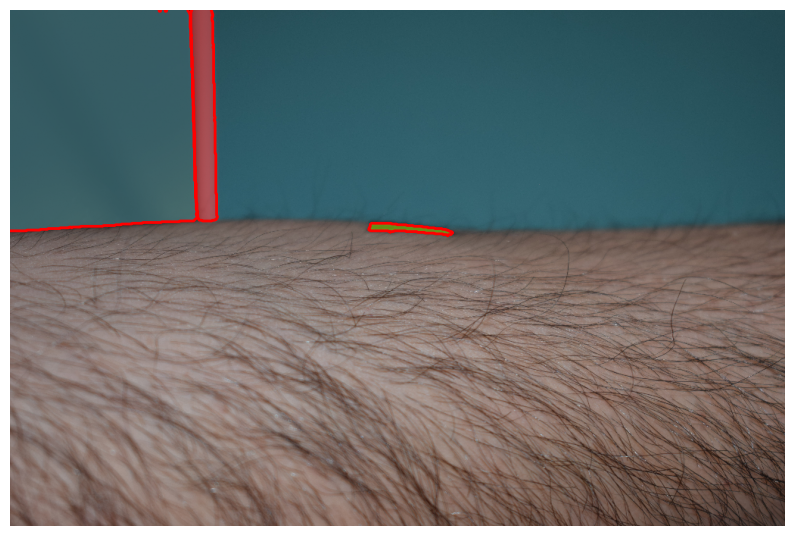

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9389_segmented.png


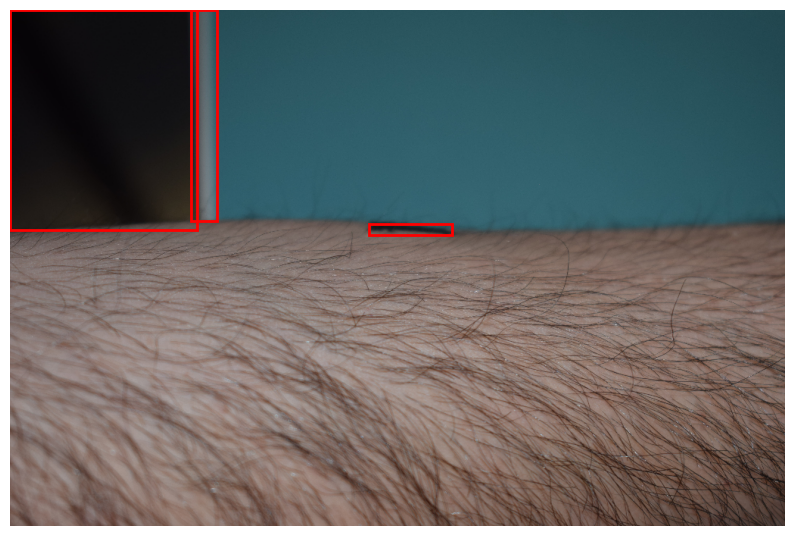

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9389_boundaries.png
Processing image: DSC_9387.jpg


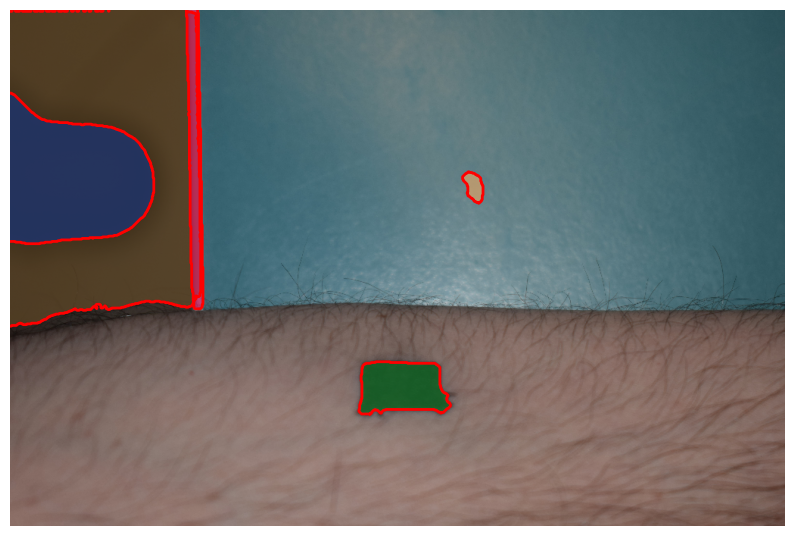

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9387_segmented.png


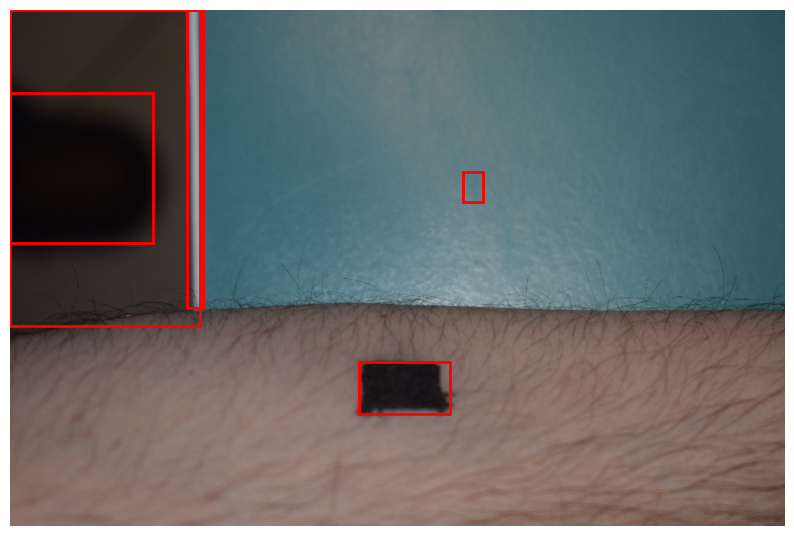

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9387_boundaries.png
Processing image: DSC_9385.jpg


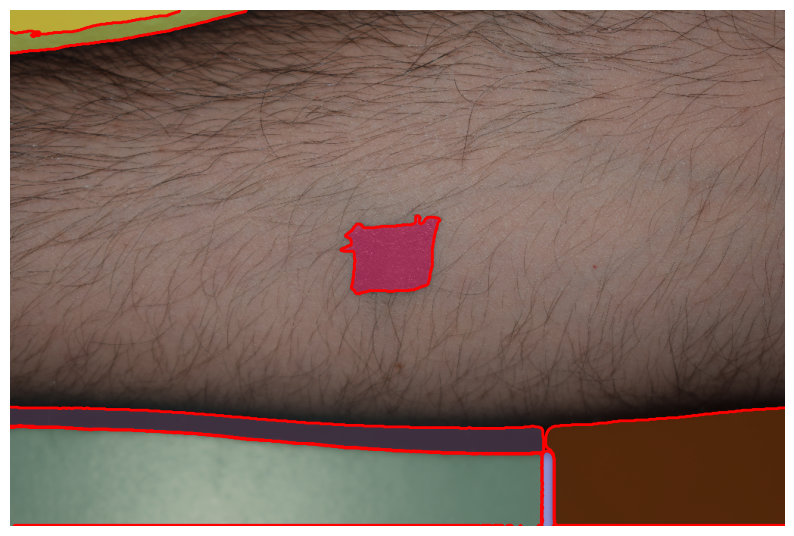

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9385_segmented.png


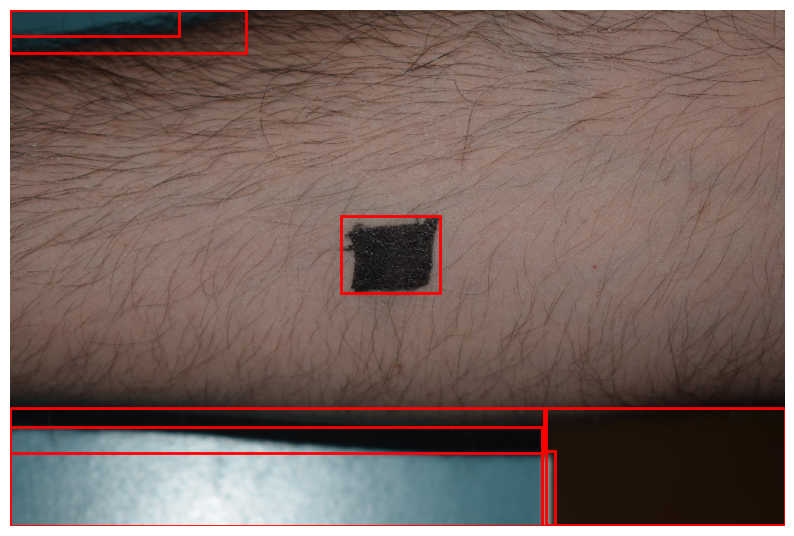

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9385_boundaries.png
Processing image: DSC_9381.jpg


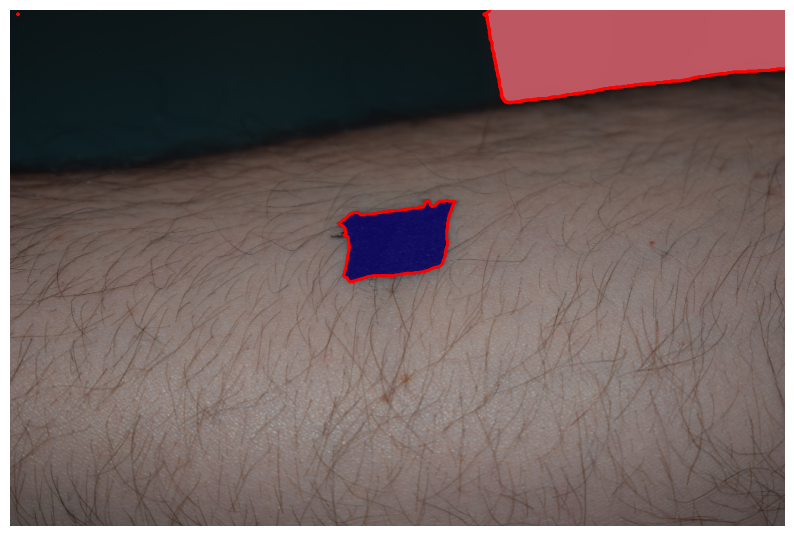

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9381_segmented.png


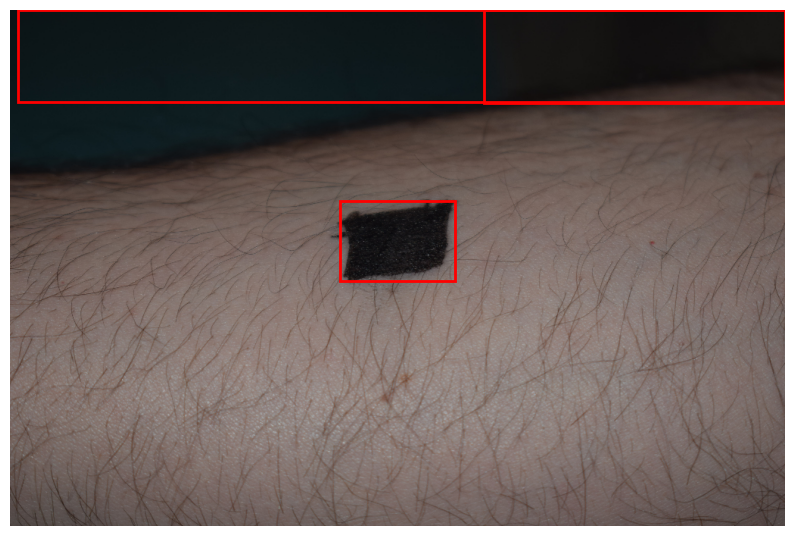

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9381_boundaries.png
Processing image: DSC_9386.jpg


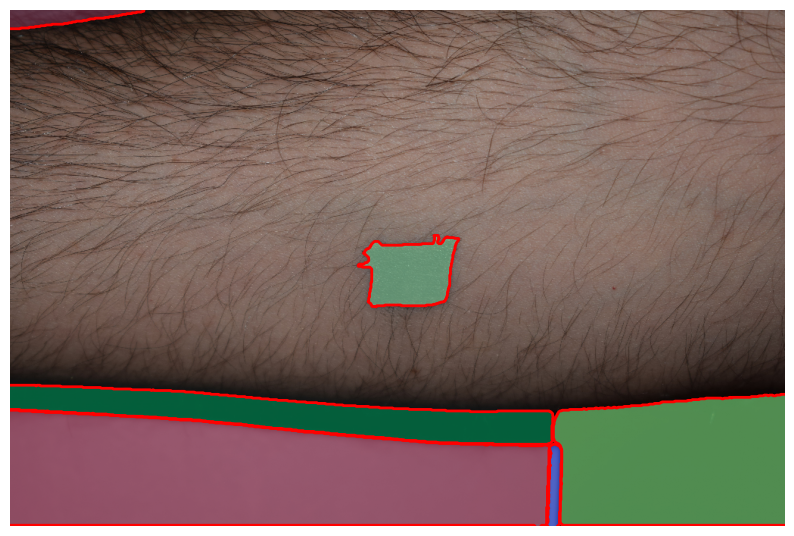

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9386_segmented.png


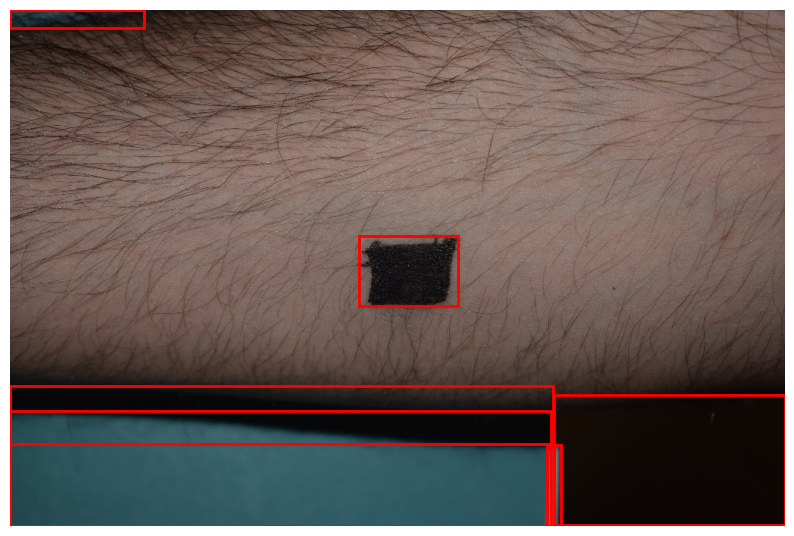

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9386_boundaries.png
Processing image: DSC_9383.jpg


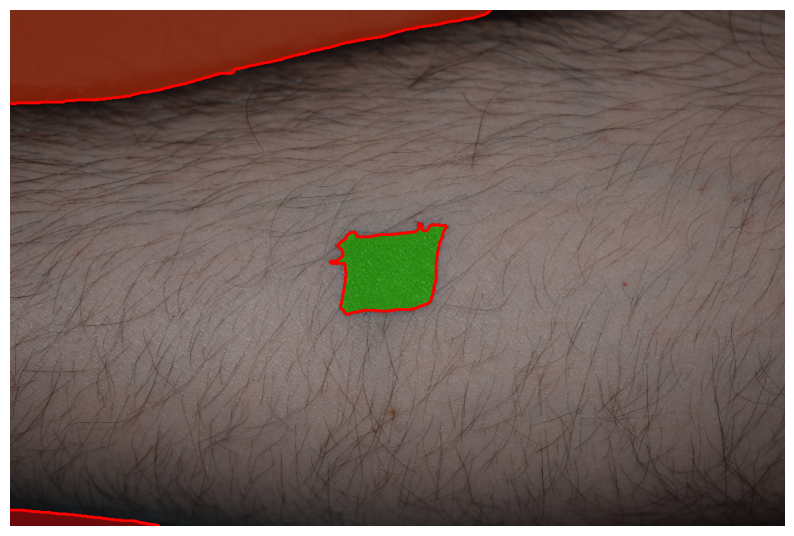

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9383_segmented.png


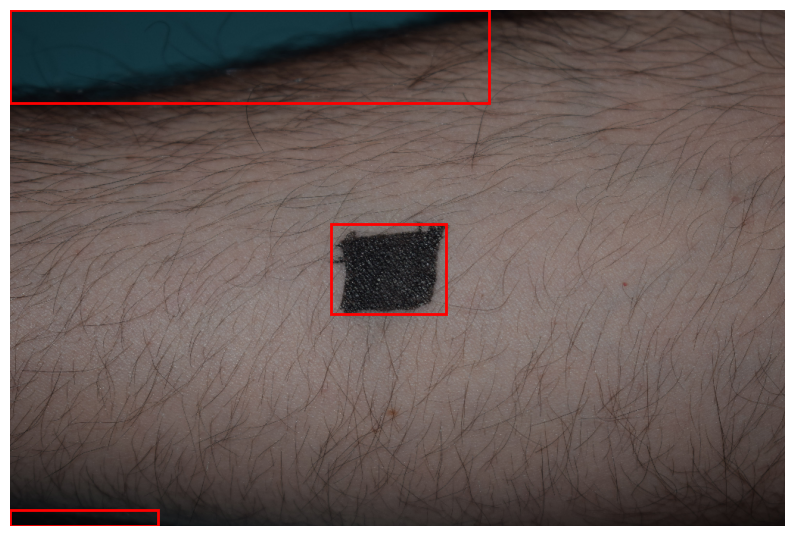

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9383_boundaries.png
Processing image: DSC_9380.jpg


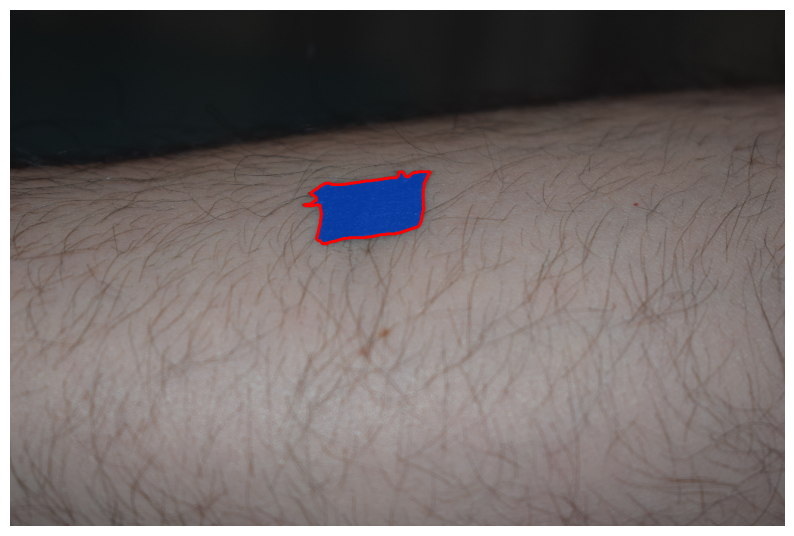

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9380_segmented.png


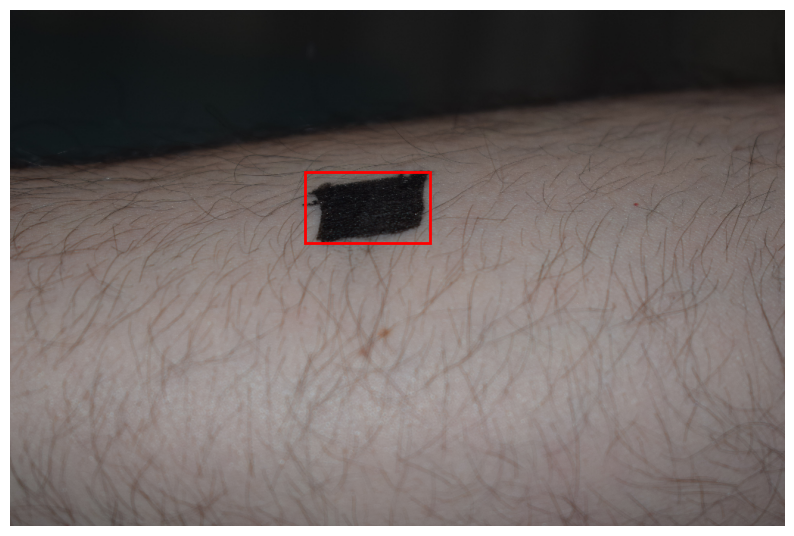

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9380_boundaries.png
Processing image: DSC_9390.jpg


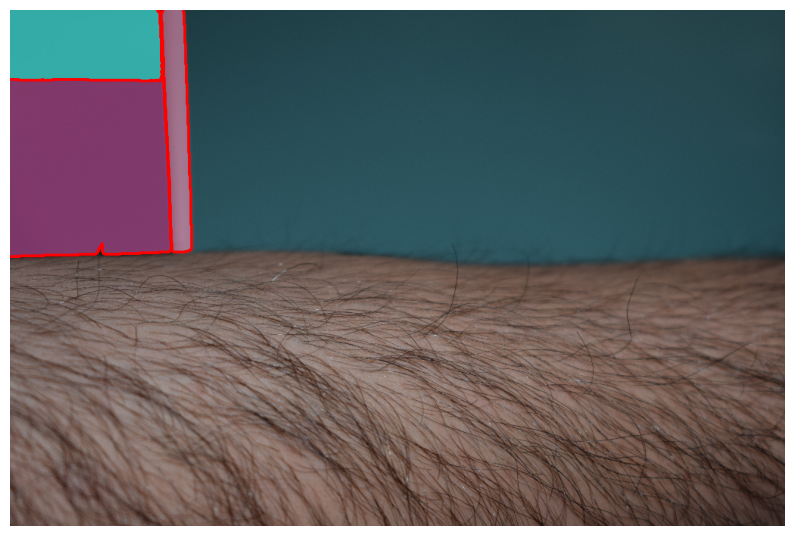

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9390_segmented.png


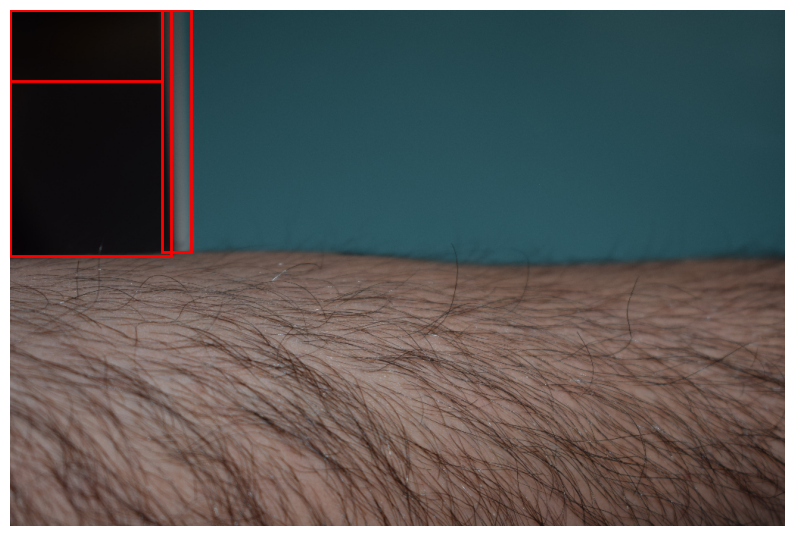

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9390_boundaries.png
Processing image: DSC_9392.jpg


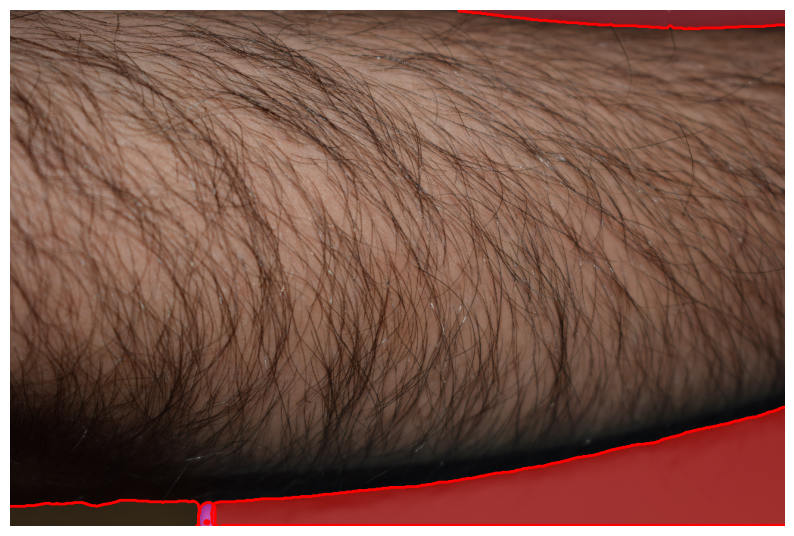

Saved segmented image to: /content/drive/MyDrive/meshroom/results/DSC_9392_segmented.png


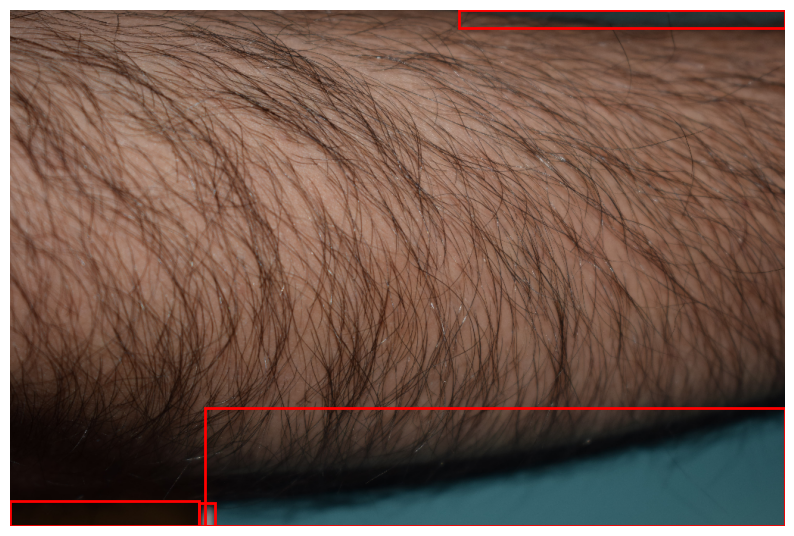

Saved boundaries image to: /content/drive/MyDrive/meshroom/results/DSC_9392_boundaries.png
Processing image: DSC_9382.jpg


In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure

# Define the folder containing the images
image_folder = '/content/drive/MyDrive/meshroom/images'  # Update this path
output_folder = '/content/drive/MyDrive/meshroom/results'
os.makedirs(output_folder, exist_ok=True)

# Define the minimum area for filtering masks
min_area = 500  # Adjust this as needed
max_area = 100000  # Adjust this as needed

# Helper functions
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)
    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

def show_boxes(anns, ax):
    for ann in anns:
        box = ann['bbox']
        x0, y0, w, h = box
        ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='red', facecolor=(0,0,0,0), lw=2))

def show_boundaries(mask, ax, color='red'):
    contours = measure.find_contours(mask, 0.5)
    for contour in contours:
        ax.plot(contour[:, 1], contour[:, 0], color=color, linewidth=2)

# Loop through each image in the folder
for image_name in os.listdir(image_folder):
    if image_name.lower().endswith(('.png', '.jpg', '.jpeg')):
        print(f"Processing image: {image_name}")

        # Load the image
        image_path = os.path.join(image_folder, image_name)
        image = cv2.imread(image_path)
        if image is None:
            print(f"Failed to load image: {image_name}")
            continue

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Resize the image to reduce memory usage
        max_size = 1024  # Set the maximum size of the longest dimension
        scale = max_size / max(image.shape[0], image.shape[1])
        image = cv2.resize(image, (int(image.shape[1] * scale), int(image.shape[0] * scale)))

        # Generate masks
        masks = mask_generator.generate(image)

        # Filter masks based on area
        filtered_masks = [mask for mask in masks if mask['area'] > min_area]
        filtered_masks = [mask for mask in filtered_masks if mask['area'] < max_area]

        if not filtered_masks:
            print(f"No masks found for image: {image_name}")
            continue

        # Plot the original image with masks and boundaries
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        for mask in filtered_masks:
            show_mask(mask['segmentation'], plt.gca(), random_color=True)
            show_boundaries(mask['segmentation'], plt.gca(), color='red')
        plt.axis('off')
        plt.show()

        # Save the plot to the output folder
        output_path = os.path.join(output_folder, f"{os.path.splitext(image_name)[0]}_segmented.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()
        print(f"Saved segmented image to: {output_path}")

        # Display boundaries only
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        show_boxes(filtered_masks, plt.gca())
        plt.axis('off')
        plt.show()

        # Save the plot with boundaries only
        output_path = os.path.join(output_folder, f"{os.path.splitext(image_name)[0]}_boundaries.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()
        print(f"Saved boundaries image to: {output_path}")


## TESTS FOR Combining Adaptive Threshold and SAM Masks


## TEST 1

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure
import torch
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# Define the folder containing the images
image_folder = '/content/images'  # Update this path
output_folder = '/content/results'
os.makedirs(output_folder, exist_ok=True)

# Load the SAM model
sam_checkpoint = "sam_vit_h_4b8939.pth"  # Update the checkpoint path if necessary
model_type = "vit_h"
device = "cuda" if torch.cuda.is_available() else "cpu"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

# Create SAM automatic mask generator
mask_generator = SamAutomaticMaskGenerator(sam)

# Helper functions
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_boundaries(mask, ax, color='red'):
    contours = measure.find_contours(mask, 0.5)
    for contour in contours:
        ax.plot(contour[:, 1], contour[:, 0], color=color, linewidth=2)

# Loop through each image in the folder
for image_name in os.listdir(image_folder):
    if image_name.lower().endswith(('.png', '.jpg', '.jpeg')):
        print(f"Processing image: {image_name}")

        # Load the image
        image_path = os.path.join(image_folder, image_name)
        image = cv2.imread(image_path)
        if image is None:
            print(f"Failed to load image: {image_name}")
            continue

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Resize the image to reduce memory usage
        max_size = 256  # Set the maximum size of the longest dimension
        scale = max_size / max(image.shape[0], image.shape[1])
        resized_image = cv2.resize(image, (int(image.shape[1] * scale), int(image.shape[0] * scale)))

        # Generate masks using SAM automatic mask generator
        masks = mask_generator.generate(resized_image)

        if not masks:
            print(f"No masks generated for image: {image_name}")
            continue

        # Select the smallest mask based on area
        #smallest_mask = max(masks, key=lambda x: x['area'])

        # Plot and save SAM mask generator results
        plt.figure(figsize=(10, 10))
        plt.imshow(resized_image)
        show_mask(smallest_mask['segmentation'], plt.gca(), random_color=True)
        plt.axis('off')
        plt.show()
        plt.title("SAM Mask Generator Results - Smallest Mask")
        output_path = os.path.join(output_folder, f"{os.path.splitext(image_name)[0]}_sam_smallest.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()
        print(f"Saved SAM mask generator image to: {output_path}")

        # Plot the original image with the mask and boundaries
        plt.figure(figsize=(10, 10))
        plt.imshow(resized_image)
        show_mask(smallest_mask['segmentation'], plt.gca(), random_color=True)
        show_boundaries(smallest_mask['segmentation'], plt.gca(), color='red')
        plt.axis('off')
        plt.show()
        plt.title("Original Image with Smallest Predicted Mask and Boundaries")
        output_path = os.path.join(output_folder, f"{os.path.splitext(image_name)[0]}_mask_smallest.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()
        print(f"Saved smallest mask image to: {output_path}")

        # Display boundaries only
        plt.figure(figsize=(10, 10))
        plt.imshow(resized_image)
        show_boundaries(smallest_mask['segmentation'], plt.gca(), color='red')
        plt.axis('off')
        plt.title("Boundaries of the Predicted Mask")
        plt.show()
        output_path = os.path.join(output_folder, f"{os.path.splitext(image_name)[0]}_boundaries_smallest.png")
        plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
        plt.close()
        print(f"Saved boundaries image to: {output_path}")


## TEST 2



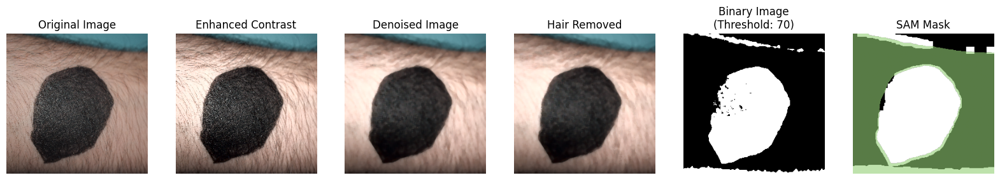

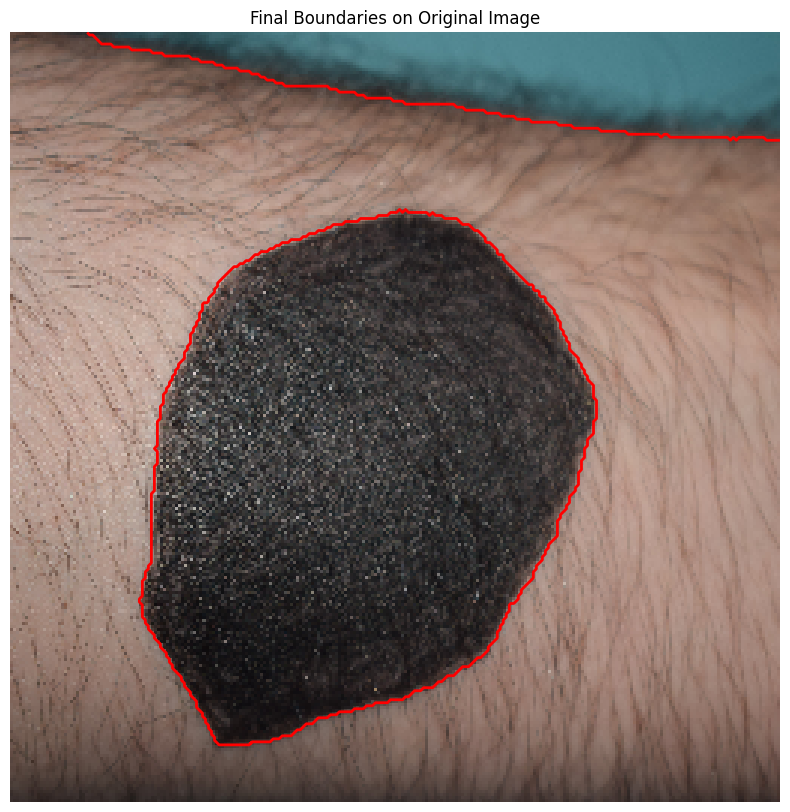

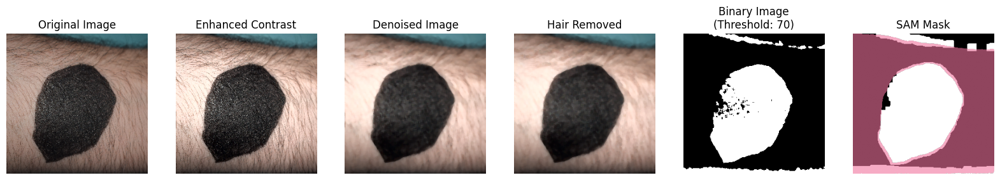

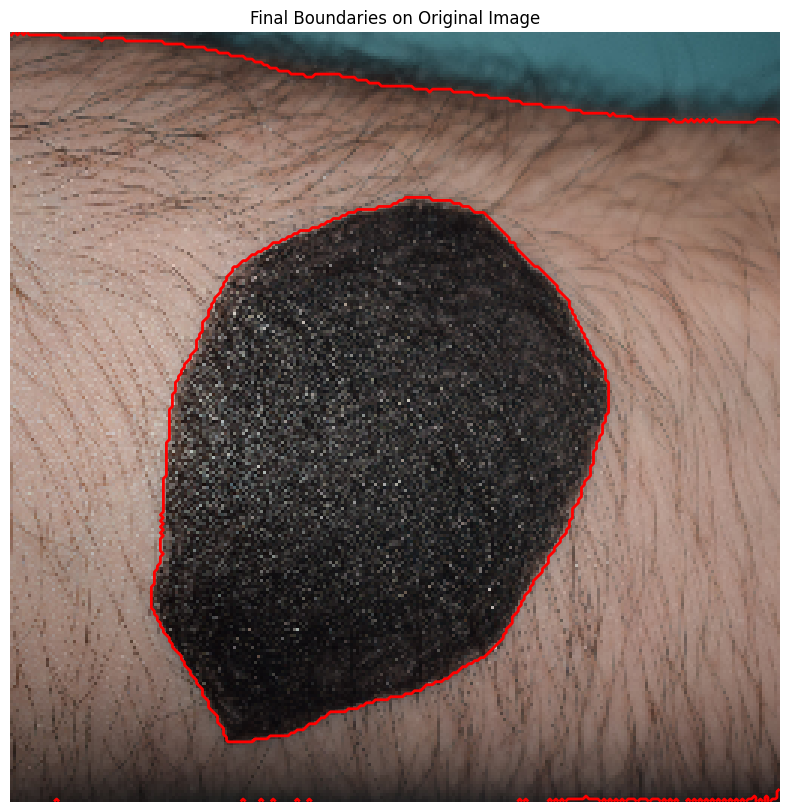

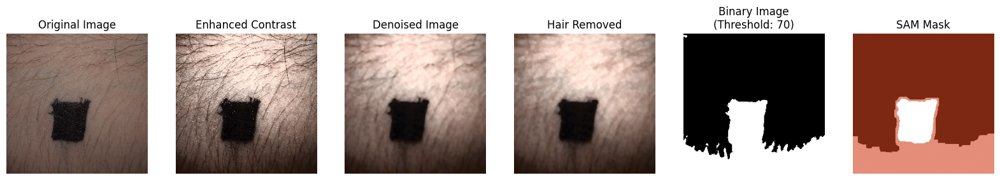

...

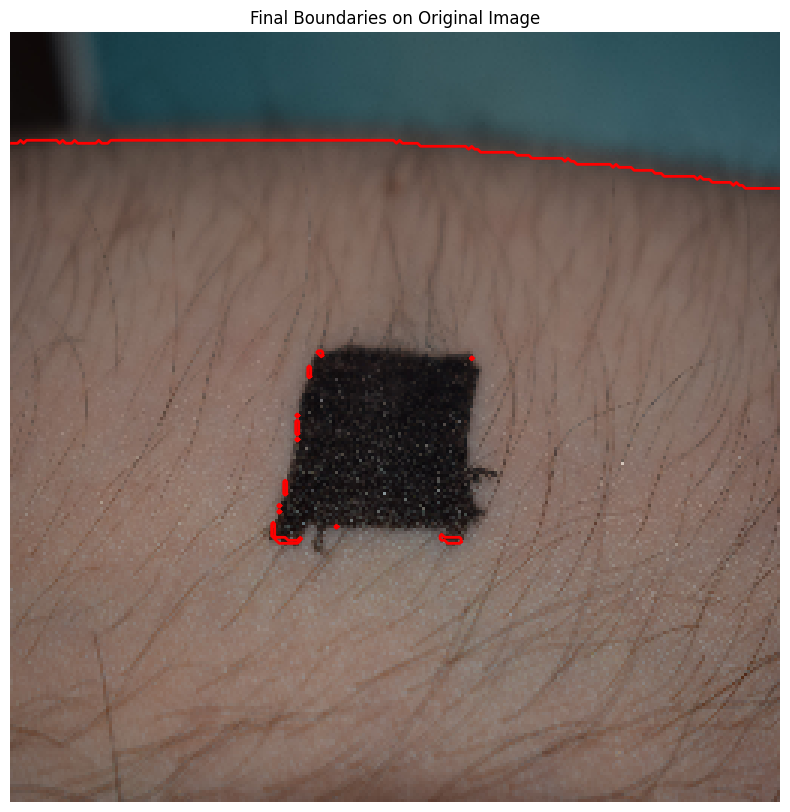

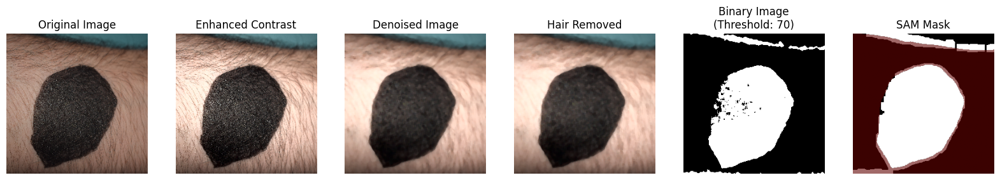

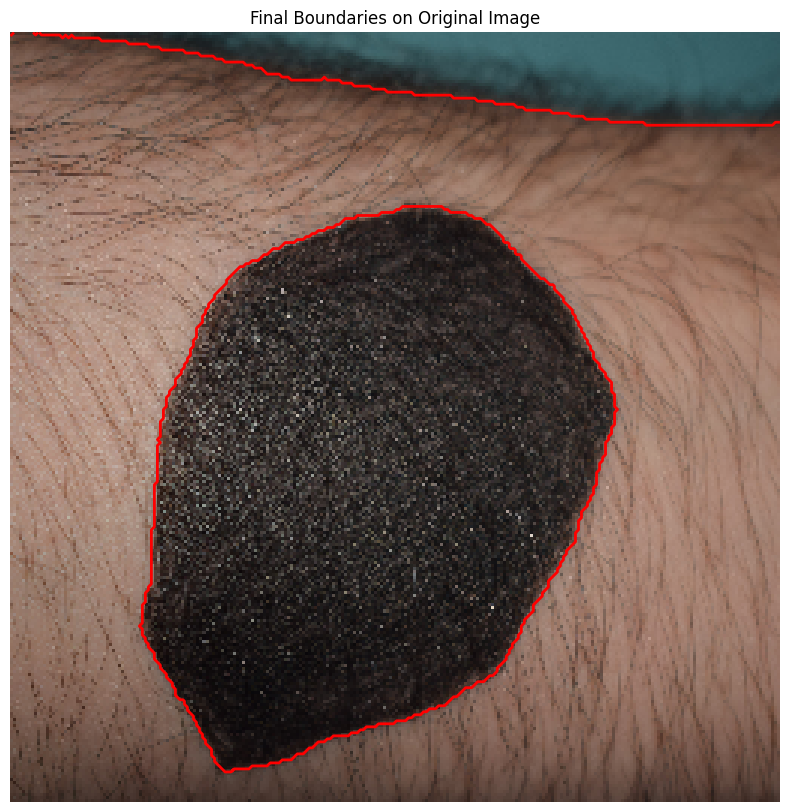

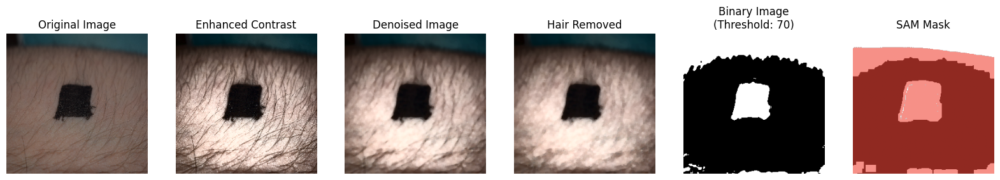

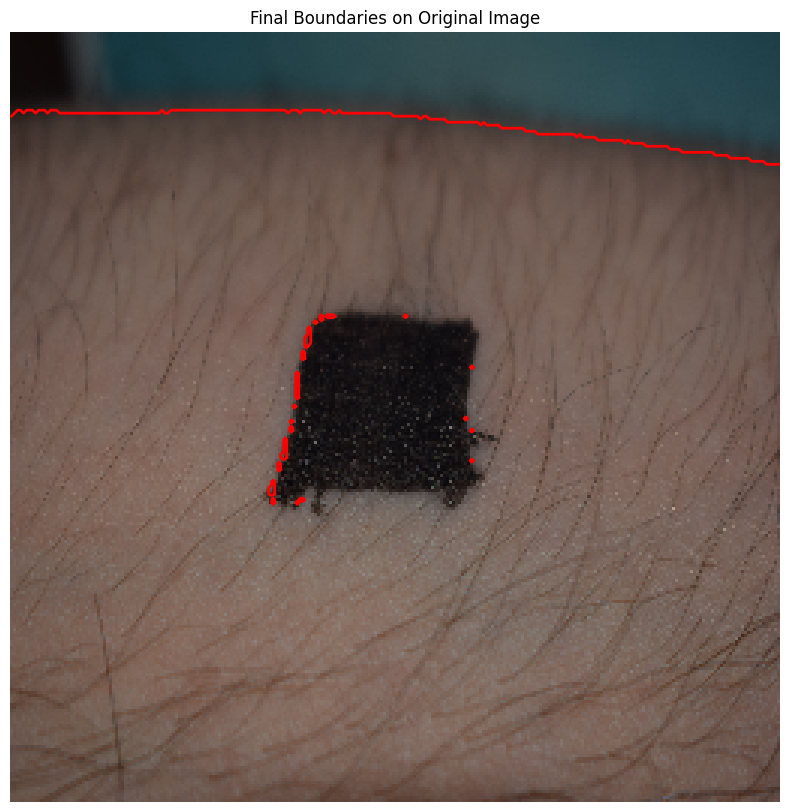

Processing and saving of images completed.


In [31]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure
import torch
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# Ensure results directory exists
results_dir = '/content/results/segment'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((5, 5), np.uint8)

# Function to remove hair artifacts
def remove_hair(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blackhat = cv2.morphologyEx(gray_image, cv2.MORPH_BLACKHAT, kernel)
    _, thresh = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    hair_removed = cv2.inpaint(image, thresh, 1, cv2.INPAINT_TELEA)
    return hair_removed

def calculate_adaptive_threshold(gray_image, min_threshold=40, max_threshold=70, adjustment_factor=35):
    """
    Calculate adaptive threshold based on the darkest part of the image with min and max limits.

    Parameters:
    - gray_image: Grayscale image for which to calculate the threshold.
    - min_threshold: Minimum threshold value.
    - max_threshold: Maximum threshold value.
    - adjustment_factor: Factor to adjust the threshold based on the darkest part.

    Returns:
    - threshold_value: Calculated threshold value.
    """
    # Calculate histogram
    hist = cv2.calcHist([gray_image], [0], None, [256], [0, 256])
    # Find the darkest part
    darkest = np.where(hist == np.max(hist[:128]))[0][0]
    # Set the threshold closer to the darkest part with limits
    threshold_value = darkest + adjustment_factor
    threshold_value = max(min_threshold, min(threshold_value, max_threshold))
    return threshold_value

# Load the SAM model
sam_checkpoint = "sam_vit_h_4b8939.pth"  # Update the checkpoint path if necessary
model_type = "vit_h"
device = "cuda" if torch.cuda.is_available() else "cpu"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

# Create SAM automatic mask generator
mask_generator = SamAutomaticMaskGenerator(sam)

# Helper functions
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_boundaries(mask, ax, color='red'):
    contours = measure.find_contours(mask, 0.5)
    for contour in contours:
        ax.plot(contour[:, 1], contour[:, 0], color=color, linewidth=2)

# Process each image in the /content/images/ directory
images_dir = '/content/segment'
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Resize the image to 256x256 pixels
        image = cv2.resize(image, (256, 256))

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Convert to grayscale
        gray_image = cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2GRAY)

        # Calculate adaptive threshold
        adaptive_threshold = calculate_adaptive_threshold(gray_image)

        # Apply a binary threshold based on the adaptive threshold
        _, binary_image = cv2.threshold(gray_image, adaptive_threshold, 255, cv2.THRESH_BINARY_INV)

        # Apply morphological operations to focus on areas rather than single pixels
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image to enlarge the area of the regions
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Use the SAM model to generate masks
        resized_image = cv2.cvtColor(dilated_image, cv2.COLOR_GRAY2RGB)
        masks = mask_generator.generate(hair_removed_image)

        if not masks:
            print(f"No masks generated for image: {filename}")
            continue

        # Select the smallest mask based on area
        smallest_mask = max(masks, key=lambda x: x['area'])

        # Display the results and save them to the results directory
        plt.figure(figsize=(20, 10))
        plt.subplot(1, 6, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 6, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 6, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 6, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 6, 5)
        plt.imshow(binary_image, cmap='gray')
        plt.title(f'Binary Image\n(Threshold: {adaptive_threshold})')
        plt.axis('off')

        plt.subplot(1, 6, 6)
        plt.imshow(resized_image)
        show_mask(smallest_mask['segmentation'], plt.gca(), random_color=True)
        plt.title('SAM Mask')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

        # Plot the final result with boundaries on the original image
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        show_boundaries(smallest_mask['segmentation'], plt.gca(), color='red')
        plt.title('Final Boundaries on Original Image')
        plt.axis('off')

        # Save the final boundaries plot
        final_result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_final_boundaries.png")
        plt.savefig(final_result_path)

        # Show the final boundaries plot
        plt.show()
        plt.close()

print("Processing and saving of images completed.")


## TEST 3

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure
import torch
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# Ensure results directory exists
results_dir = '/content/results/segment'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((5, 5), np.uint8)

# Function to remove hair artifacts
def remove_hair(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blackhat = cv2.morphologyEx(gray_image, cv2.MORPH_BLACKHAT, kernel)
    _, thresh = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    hair_removed = cv2.inpaint(image, thresh, 1, cv2.INPAINT_TELEA)
    return hair_removed

def calculate_adaptive_threshold(gray_image, min_threshold=40, max_threshold=70, adjustment_factor=35):
    """
    Calculate adaptive threshold based on the darkest part of the image with min and max limits.

    Parameters:
    - gray_image: Grayscale image for which to calculate the threshold.
    - min_threshold: Minimum threshold value.
    - max_threshold: Maximum threshold value.
    - adjustment_factor: Factor to adjust the threshold based on the darkest part.

    Returns:
    - threshold_value: Calculated threshold value.
    """
    # Calculate histogram
    hist = cv2.calcHist([gray_image], [0], None, [256], [0, 256])
    # Find the darkest part
    darkest = np.where(hist == np.max(hist[:128]))[0][0]
    # Set the threshold closer to the darkest part with limits
    threshold_value = darkest + adjustment_factor
    threshold_value = max(min_threshold, min(threshold_value, max_threshold))
    return threshold_value

def evaluate_mask(mask, image_shape):
    """
    Evaluate the mask based on its size and compactness.

    Parameters:
    - mask: The mask to evaluate.
    - image_shape: The shape of the original image.

    Returns:
    - score: A score representing the mask's suitability as a lesion.
    """
    # Calculate the area of the mask
    area = np.sum(mask)

    # Calculate the bounding box of the mask
    labeled_mask, num_features = measure.label(mask, return_num=True, connectivity=2)
    regions = measure.regionprops(labeled_mask)
    if len(regions) == 0:
        return 0

    # Calculate the compactness (perimeter^2 / area) of the largest region
    region = max(regions, key=lambda r: r.area)
    perimeter = region.perimeter
    compactness = (perimeter ** 2) / area

    # Consider the size and compactness to evaluate the mask
    image_area = image_shape[0] * image_shape[1]
    size_ratio = area / image_area
    size_score = 1 if 0.01 < size_ratio < 0.5 else 0
    compactness_score = 1 / (1 + compactness)

    return size_score * compactness_score

# Load the SAM model
sam_checkpoint = "sam_vit_h_4b8939.pth"  # Update the checkpoint path if necessary
model_type = "vit_h"
device = "cuda" if torch.cuda.is_available() else "cpu"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

# Create SAM automatic mask generator
mask_generator = SamAutomaticMaskGenerator(sam)

# Helper functions
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_boundaries(mask, ax, color='red'):
    contours = measure.find_contours(mask, 0.5)
    for contour in contours:
        ax.plot(contour[:, 1], contour[:, 0], color=color, linewidth=2)

# Process each image in the /content/images/ directory
images_dir = '/content/segment'
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Resize the image to 256x256 pixels
        image = cv2.resize(image, (256, 256))

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Convert to grayscale
        gray_image = cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2GRAY)

        # Calculate adaptive threshold
        adaptive_threshold = calculate_adaptive_threshold(gray_image)

        # Apply a binary threshold based on the adaptive threshold
        _, binary_image = cv2.threshold(gray_image, adaptive_threshold, 255, cv2.THRESH_BINARY_INV)

        # Apply morphological operations to focus on areas rather than single pixels
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image to enlarge the area of the regions
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Invert the adaptive threshold mask to match SAM's mask format (lesions in white)
        adaptive_mask = cv2.bitwise_not(dilated_image)

        # Use the SAM model to generate masks
        resized_image = cv2.cvtColor(adaptive_mask, cv2.COLOR_GRAY2RGB)
        masks = mask_generator.generate(resized_image)

        if not masks:
            print(f"No masks generated for image: {filename}")
            continue

        # Combine the adaptive threshold mask and the SAM mask
        best_sam_mask = max(masks, key=lambda x: x['area'])
        sam_mask = best_sam_mask['segmentation']

        # Convert SAM mask to binary format
        sam_mask_binary = sam_mask.astype(np.uint8) * 255

        # Create an empty combined mask
        combined_mask = np.zeros_like(adaptive_mask)

        # Combine masks: use the adaptive mask for areas not detected by SAM, and use SAM's mask for the rest
        combined_mask[adaptive_mask == 255] = 255
        combined_mask[sam_mask_binary == 255] = 255

        # Display the results and save them to the results directory
        plt.figure(figsize=(25, 10))
        plt.subplot(1, 10, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 10, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 10, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 10, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 10, 5)
        plt.imshow(adaptive_mask, cmap='gray')
        plt.title(f'Adaptive Mask\n(Threshold: {adaptive_threshold})')
        plt.axis('off')

        plt.subplot(1, 10, 6)
        plt.imshow(sam_mask_binary, cmap='gray')
        plt.title('SAM Mask')
        plt.axis('off')

        plt.subplot(1, 10, 7)
        plt.imshow(adaptive_mask, cmap='gray')
        plt.title('Adaptive Threshold Mask')
        plt.axis('off')

        plt.subplot(1, 10, 8)
        plt.imshow(combined_mask, cmap='gray')
        plt.title('Combined Mask')
        plt.axis('off')

        plt.subplot(1, 10, 9)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        show_boundaries(combined_mask, plt.gca(), color='red')
        plt.title('Final Boundaries')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

        # Plot the final result with boundaries on the original image
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        show_boundaries(combined_mask, plt.gca(), color='red')
        plt.title('Final Boundaries on Original Image')
        plt.axis('off')

        # Save the final boundaries plot
        final_result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_final_boundaries.png")
        plt.savefig(final_result_path)

        # Show the final boundaries plot
        plt.show()
        plt.close()

print("Processing and saving of images completed.")


## TEST 4

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure
import torch
import torch.nn as nn
from torchvision import transforms
import pickle

# Ensure results directory exists
results_dir = '/content/results/skinsam'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((5, 5), np.uint8)

# Function to remove hair artifacts
def remove_hair(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blackhat = cv2.morphologyEx(gray_image, cv2.MORPH_BLACKHAT, kernel)
    _, thresh = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    hair_removed = cv2.inpaint(image, thresh, 1, cv2.INPAINT_TELEA)
    return hair_removed

# Function to load the SkinSAM model
def load_skinsam_model(model_path):
    with open(model_path, 'rb') as f:
        model = pickle.load(f)
    model.eval()
    return model

# Function to perform prediction with the SkinSAM model
def predict_with_skinsam(model, image):
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
    ])
    input_tensor = preprocess(image).unsqueeze(0)  # Add batch dimension
    with torch.no_grad():
        output = model(input_tensor)
    return output.squeeze().numpy()

# Load the SkinSAM model
model_path = '/content/data.pkl'  # Update the path to the downloaded model
skinsam_model = load_skinsam_model(model_path)

# Helper functions
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_boundaries(mask, ax, color='red'):
    contours = measure.find_contours(mask, 0.5)
    for contour in contours:
        ax.plot(contour[:, 1], contour[:, 0], color=color, linewidth=2)

# Process each image in the /content/images/ directory
images_dir = '/content/images'
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Resize the image to 256x256 pixels
        image = cv2.resize(image, (256, 256))

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Step 4: Predict with SkinSAM model
        mask = predict_with_skinsam(skinsam_model, hair_removed_image)

        # Convert mask to binary
        binary_mask = (mask > 0.5).astype(np.uint8) * 255

        # Display the results and save them to the results directory
        plt.figure(figsize=(25, 10))
        plt.subplot(1, 7, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 7, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 7, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 7, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 7, 5)
        plt.imshow(binary_mask, cmap='gray')
        plt.title('SkinSAM Mask')
        plt.axis('off')

        plt.subplot(1, 7, 6)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        show_boundaries(binary_mask, plt.gca(), color='red')
        plt.title('Final Boundaries')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

        # Plot the final result with boundaries on the original image
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        show_boundaries(binary_mask, plt.gca(), color='red')
        plt.title('Final Boundaries on Original Image')
        plt.axis('off')

        # Save the final boundaries plot
        final_result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_final_boundaries.png")
        plt.savefig(final_result_path)

        # Show the final boundaries plot
        plt.show()
        plt.close()

print("Processing and saving of images completed.")


## Combine Adaptive Threshold and SAM Masks

We combine the results from an adaptive threshold mask and the SAM-generated masks to achieve better segmentation. The combination process helps to leverage the strengths of both methods.


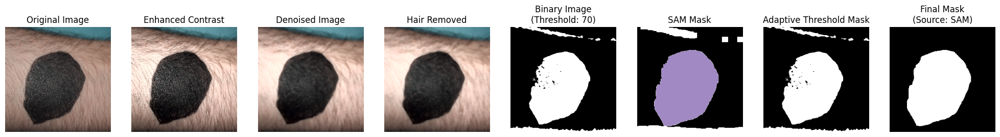

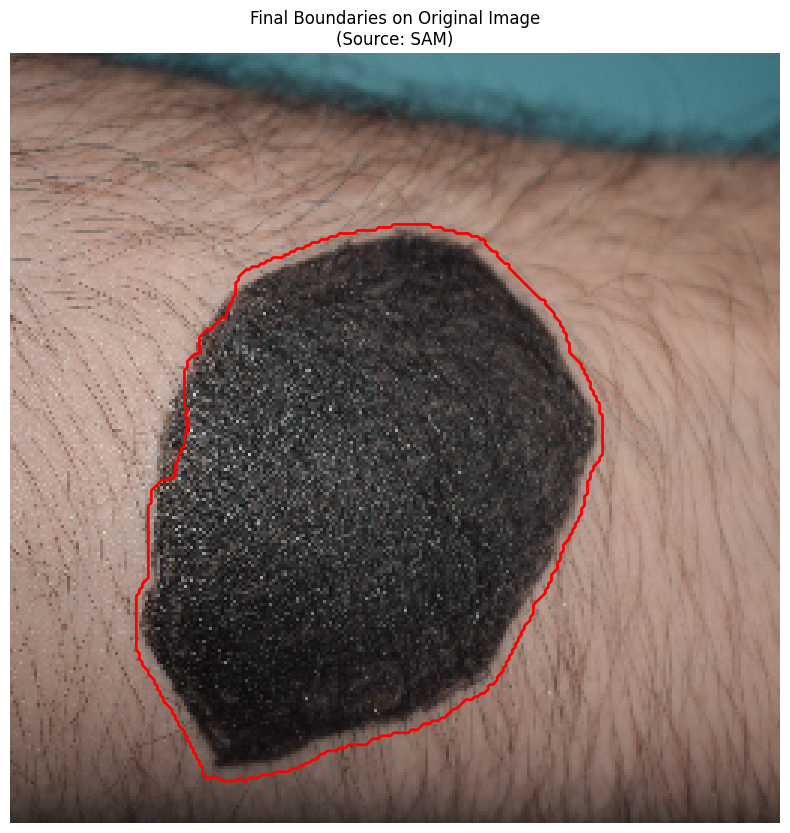

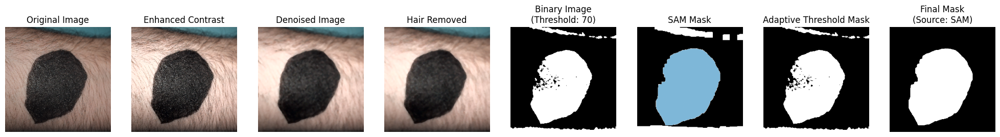

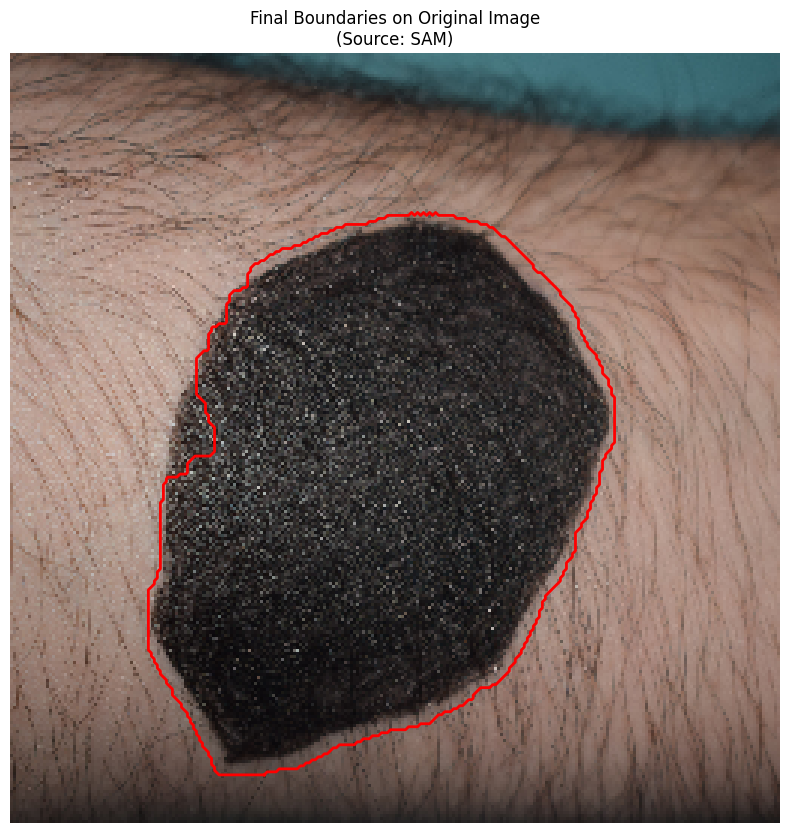

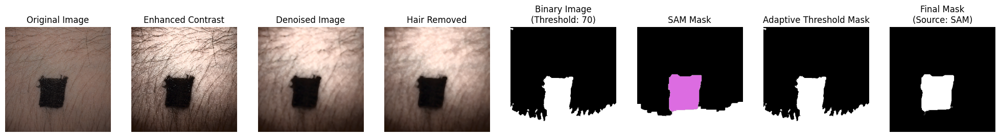

...

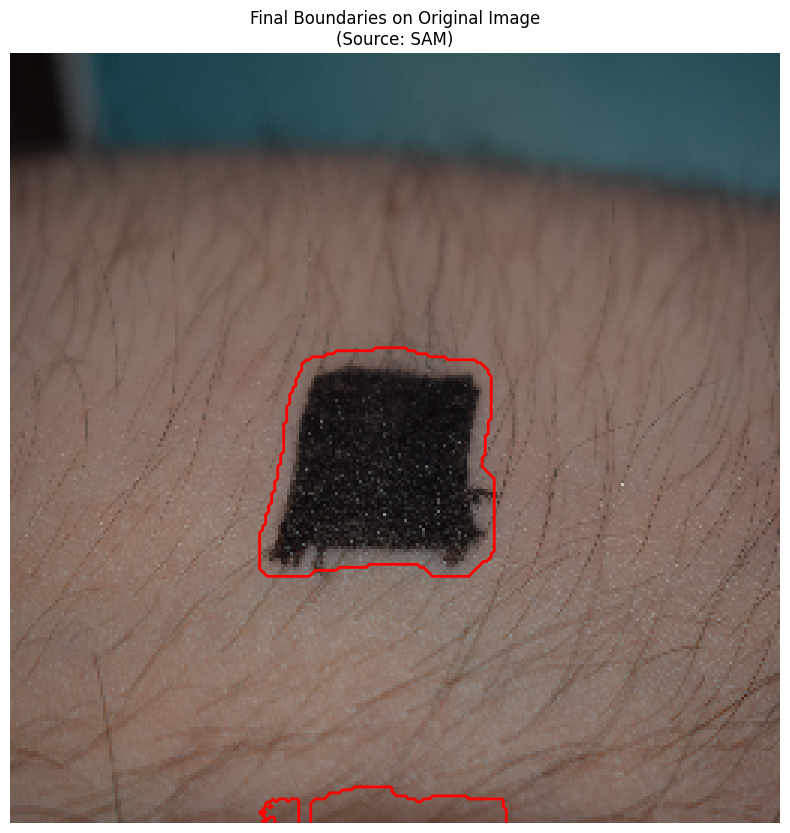

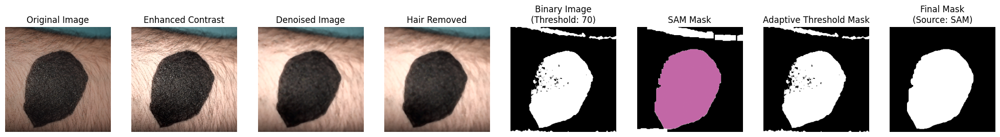

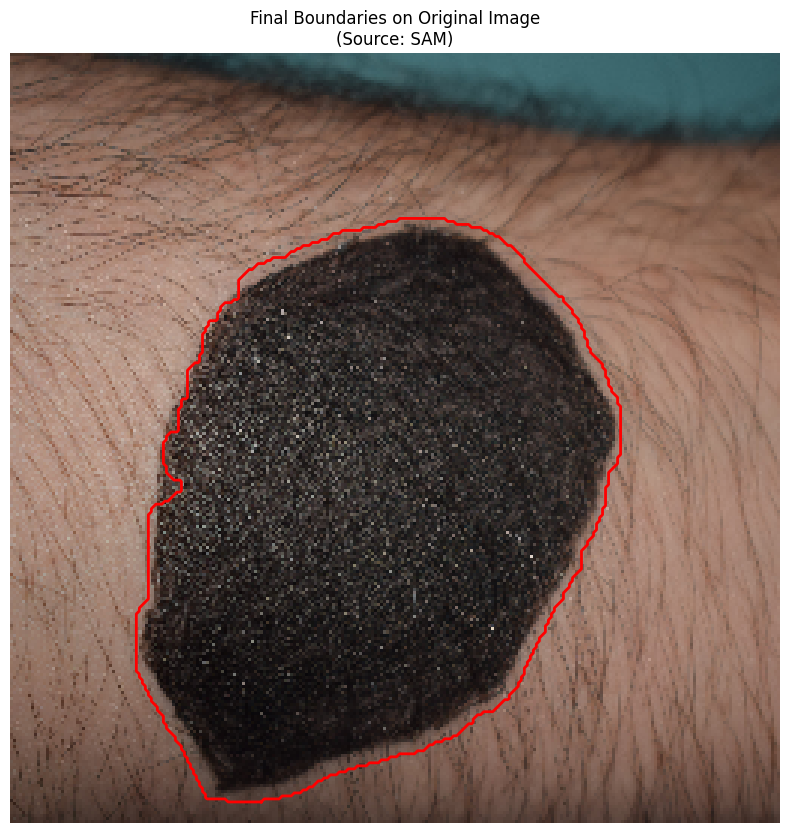

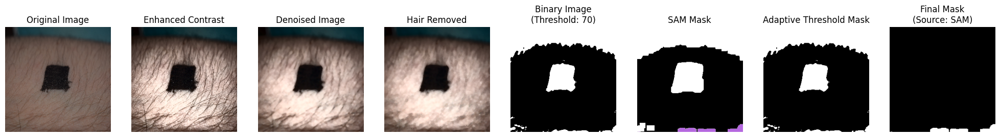

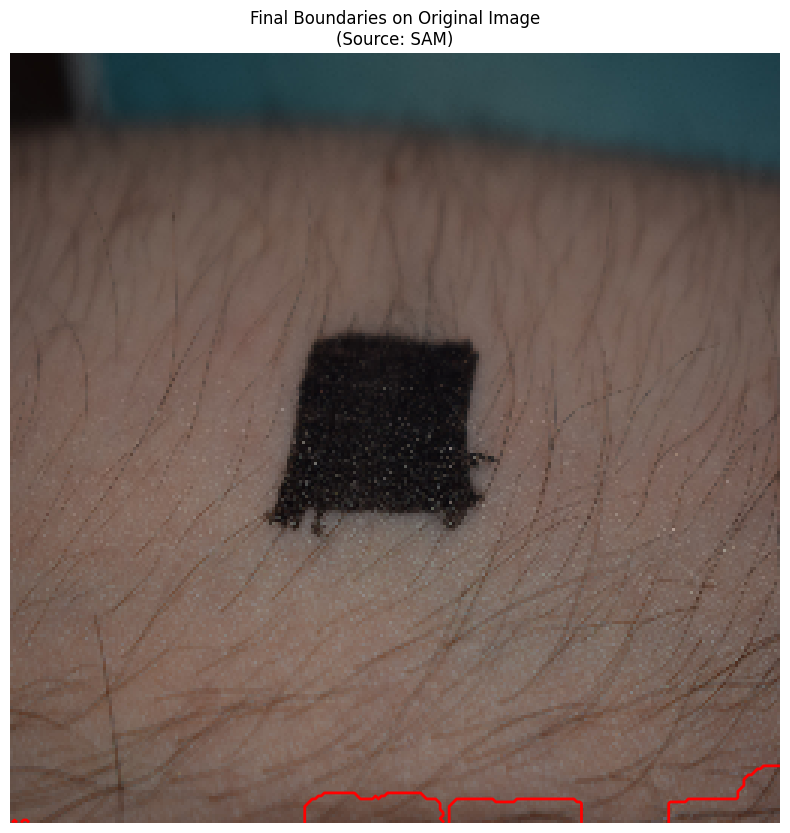

Processing and saving of images completed.


In [29]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import measure
import torch
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator

# Ensure results directory exists
results_dir = '/content/results'
os.makedirs(results_dir, exist_ok=True)

# Define the kernel for morphological operations
kernel = np.ones((5, 5), np.uint8)

# Function to remove hair artifacts
def remove_hair(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blackhat = cv2.morphologyEx(gray_image, cv2.MORPH_BLACKHAT, kernel)
    _, thresh = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY)
    hair_removed = cv2.inpaint(image, thresh, 1, cv2.INPAINT_TELEA)
    return hair_removed

def calculate_adaptive_threshold(gray_image, min_threshold=40, max_threshold=70, adjustment_factor=35):
    """
    Calculate adaptive threshold based on the darkest part of the image with min and max limits.

    Parameters:
    - gray_image: Grayscale image for which to calculate the threshold.
    - min_threshold: Minimum threshold value.
    - max_threshold: Maximum threshold value.
    - adjustment_factor: Factor to adjust the threshold based on the darkest part.

    Returns:
    - threshold_value: Calculated threshold value.
    """
    # Calculate histogram
    hist = cv2.calcHist([gray_image], [0], None, [256], [0, 256])
    # Find the darkest part
    darkest = np.where(hist == np.max(hist[:128]))[0][0]
    # Set the threshold closer to the darkest part with limits
    threshold_value = darkest + adjustment_factor
    threshold_value = max(min_threshold, min(threshold_value, max_threshold))
    return threshold_value

def evaluate_mask(mask, image_shape):
    """
    Evaluate the mask based on its size and compactness.

    Parameters:
    - mask: The mask to evaluate.
    - image_shape: The shape of the original image.

    Returns:
    - score: A score representing the mask's suitability as a lesion.
    """
    # Calculate the area of the mask
    area = np.sum(mask)

    # Calculate the bounding box of the mask
    labeled_mask, num_features = measure.label(mask, return_num=True, connectivity=2)
    regions = measure.regionprops(labeled_mask)
    if len(regions) == 0:
        return 0

    # Calculate the compactness (perimeter^2 / area) of the largest region
    region = max(regions, key=lambda r: r.area)
    perimeter = region.perimeter
    compactness = (perimeter ** 2) / area

    # Consider the size and compactness to evaluate the mask
    image_area = image_shape[0] * image_shape[1]
    size_ratio = area / image_area
    size_score = 1 if 0.01 < size_ratio < 0.5 else 0
    compactness_score = 1 / (1 + compactness)

    return size_score * compactness_score

# Load the SAM model
sam_checkpoint = "sam_vit_h_4b8939.pth"  # Update the checkpoint path if necessary
model_type = "vit_h"
device = "cuda" if torch.cuda.is_available() else "cpu"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

# Create SAM automatic mask generator
mask_generator = SamAutomaticMaskGenerator(sam)

# Helper functions
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_boundaries(mask, ax, color='red'):
    contours = measure.find_contours(mask, 0.5)
    for contour in contours:
        ax.plot(contour[:, 1], contour[:, 0], color=color, linewidth=2)

# Process each image in the /content/images/ directory
images_dir = '/content/segment'
for filename in os.listdir(images_dir):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
        # Load the image
        image_path = os.path.join(images_dir, filename)
        image = cv2.imread(image_path)

        # Resize the image to 256x256 pixels
        image = cv2.resize(image, (256, 256))

        # Step 1: Enhance contrast
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        l = cv2.equalizeHist(l)
        enhanced_image = cv2.merge((l, a, b))
        enhanced_image = cv2.cvtColor(enhanced_image, cv2.COLOR_LAB2BGR)

        # Step 2: Remove noise
        denoised_image = cv2.medianBlur(enhanced_image, 5)

        # Step 3: Remove hair artifacts
        hair_removed_image = remove_hair(denoised_image)

        # Convert to grayscale
        gray_image = cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2GRAY)

        # Calculate adaptive threshold
        adaptive_threshold = calculate_adaptive_threshold(gray_image)

        # Apply a binary threshold based on the adaptive threshold
        _, binary_image = cv2.threshold(gray_image, adaptive_threshold, 255, cv2.THRESH_BINARY_INV)

        # Apply morphological operations to focus on areas rather than single pixels
        closed_image = cv2.morphologyEx(binary_image, cv2.MORPH_CLOSE, kernel)
        opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel)

        # Dilate the image to enlarge the area of the regions
        dilated_image = cv2.dilate(opened_image, kernel, iterations=2)

        # Use the SAM model to generate masks
        resized_image = cv2.cvtColor(dilated_image, cv2.COLOR_GRAY2RGB)
        masks = mask_generator.generate(resized_image)

        if not masks:
            print(f"No masks generated for image: {filename}")
            continue

        # Generate a mask using SAM
        best_sam_mask = max(masks, key=lambda x: evaluate_mask(x['segmentation'], image.shape))

        # Evaluate both masks
        adaptive_mask_score = evaluate_mask(binary_image, image.shape)
        sam_mask_score = evaluate_mask(best_sam_mask['segmentation'], image.shape)

        # Choose the best mask
        if adaptive_mask_score > sam_mask_score:
            final_mask = binary_image
            final_mask_source = "Adaptive Threshold"
        else:
            final_mask = best_sam_mask['segmentation']
            final_mask_source = "SAM"

        # Display the results and save them to the results directory
        plt.figure(figsize=(25, 10))
        plt.subplot(1, 8, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 8, 2)
        plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
        plt.title('Enhanced Contrast')
        plt.axis('off')

        plt.subplot(1, 8, 3)
        plt.imshow(cv2.cvtColor(denoised_image, cv2.COLOR_BGR2RGB))
        plt.title('Denoised Image')
        plt.axis('off')

        plt.subplot(1, 8, 4)
        plt.imshow(cv2.cvtColor(hair_removed_image, cv2.COLOR_BGR2RGB))
        plt.title('Hair Removed')
        plt.axis('off')

        plt.subplot(1, 8, 5)
        plt.imshow(binary_image, cmap='gray')
        plt.title(f'Binary Image\n(Threshold: {adaptive_threshold})')
        plt.axis('off')

        plt.subplot(1, 8, 6)
        plt.imshow(resized_image)
        show_mask(best_sam_mask['segmentation'], plt.gca(), random_color=True)
        plt.title('SAM Mask')
        plt.axis('off')

        plt.subplot(1, 8, 7)
        plt.imshow(binary_image, cmap='gray')
        plt.title('Adaptive Threshold Mask')
        plt.axis('off')

        plt.subplot(1, 8, 8)
        plt.imshow(final_mask, cmap='gray')
        plt.title(f'Final Mask\n(Source: {final_mask_source})')
        plt.axis('off')

        # Save the figure
        result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_result.png")
        plt.savefig(result_path)

        # Show the figure
        plt.show()
        plt.close()

        # Plot the final result with boundaries on the original image
        plt.figure(figsize=(10, 10))
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        show_boundaries(final_mask, plt.gca(), color='red')
        plt.title(f'Final Boundaries on Original Image\n(Source: {final_mask_source})')
        plt.axis('off')

        # Save the final boundaries plot
        final_result_path = os.path.join(results_dir, f"{os.path.splitext(filename)[0]}_final_boundaries.png")
        plt.savefig(final_result_path)

        # Show the final boundaries plot
        plt.show()
        plt.close()

print("Processing and saving of images completed.")


## Zip and Download Results

After processing all images, we zip the results folder and provide a link to download the zip file.


In [40]:
import shutil
import os

# Define the folder containing the results
output_folder = '/content/results'
zip_output_path = '/content/results.zip'

# Zip the results folder
shutil.make_archive(output_folder, 'zip', output_folder)

# Ensure the zip file exists
if os.path.exists(zip_output_path):
    print(f"Results folder successfully zipped: {zip_output_path}")
else:
    print("Failed to zip the results folder.")

# Download the zip file (only works in Google Colab)
from google.colab import files
files.download(zip_output_path)


Results folder successfully zipped: /content/results.zip


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>